In [ ]:
# pip install opencv-python

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import json
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import cv2
from matplotlib import colors

In [ ]:
df_train = pd.read_csv('/content/drive/MyDrive/cassava-leaf-disease-classification/cassava-leaf-disease-classification/train.csv')
df_train

,image_id,label
0,1000015157.jpg,0
1,1000201771.jpg,3
2,100042118.jpg,1
3,1000723321.jpg,1
4,1000812911.jpg,3
...,...,...
21392,999068805.jpg,3
21393,999329392.jpg,3
21394,999474432.jpg,1
21395,999616605.jpg,4


In [ ]:
f = open('/content/drive/MyDrive/cassava-leaf-disease-classification/cassava-leaf-disease-classification/label_num_to_disease_map.json')
label_name = json.load(f)
label_name

{'0': 'Cassava Bacterial Blight (CBB)',
 '1': 'Cassava Brown Streak Disease (CBSD)',
 '2': 'Cassava Green Mottle (CGM)',
 '3': 'Cassava Mosaic Disease (CMD)',
 '4': 'Healthy'}

In [ ]:
def get_image(path):
  path_org = '/content/drive/MyDrive/cassava-leaf-disease-classification/cassava-leaf-disease-classification/train_images/'
  img = mpimg.imread(path_org + path)
  return img

In [ ]:
def showImages(images):

    train_path = '/content/drive/MyDrive/cassava-leaf-disease-classification/cassava-leaf-disease-classification/train_images/'

    # Extract 16 random images from it
    random_images = [np.random.choice(images) for i in range(16)]

    # Adjust the size of your images
    plt.figure(figsize=(16,12))

    # Iterate and plot random images
    for i in range(16):
        plt.subplot(4,4, i + 1)
        img = plt.imread(train_path+'/'+random_images[i])
        plt.imshow(img, cmap='gray')
        plt.axis('off')

    # Adjust subplot parameters to give specified padding
    plt.tight_layout()  

In [ ]:
df_train.shape

(21397, 2)

In [ ]:
print(df_train.label.value_counts())

3    13158
4     2577
2     2386
1     2189
0     1087
Name: label, dtype: int64


In [ ]:
label_name = {int(k):v for k, v in label_name.items()}

In [ ]:
df_cnt = df_train['label'].value_counts()
df_cnt.index.astype('str')
df_cnt = df_cnt.rename(index = label_name)
df_cnt

Cassava Mosaic Disease (CMD)           13158
Healthy                                 2577
Cassava Green Mottle (CGM)              2386
Cassava Brown Streak Disease (CBSD)     2189
Cassava Bacterial Blight (CBB)          1087
Name: label, dtype: int64

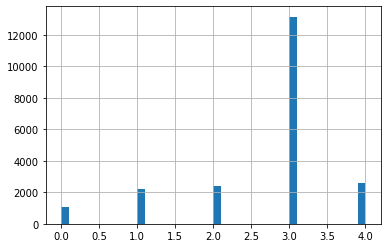

In [ ]:
# plt.figure(figsize=(16,10))
# sns.barplot(df_cnt.index, df_cnt.values, alpha=0.9, orient = "v")
# plt.ylabel('Frequency', labelpad=45, fontsize = 16)
# plt.xlabel('Type of Cassava Leaf Disease', labelpad = 45, fontsize = 16)
# plt.title("Count of Cassava Leaf Disease", y = 1.05, fontsize = 20)
# plt.show()
df_train['label'].hist(bins=40)

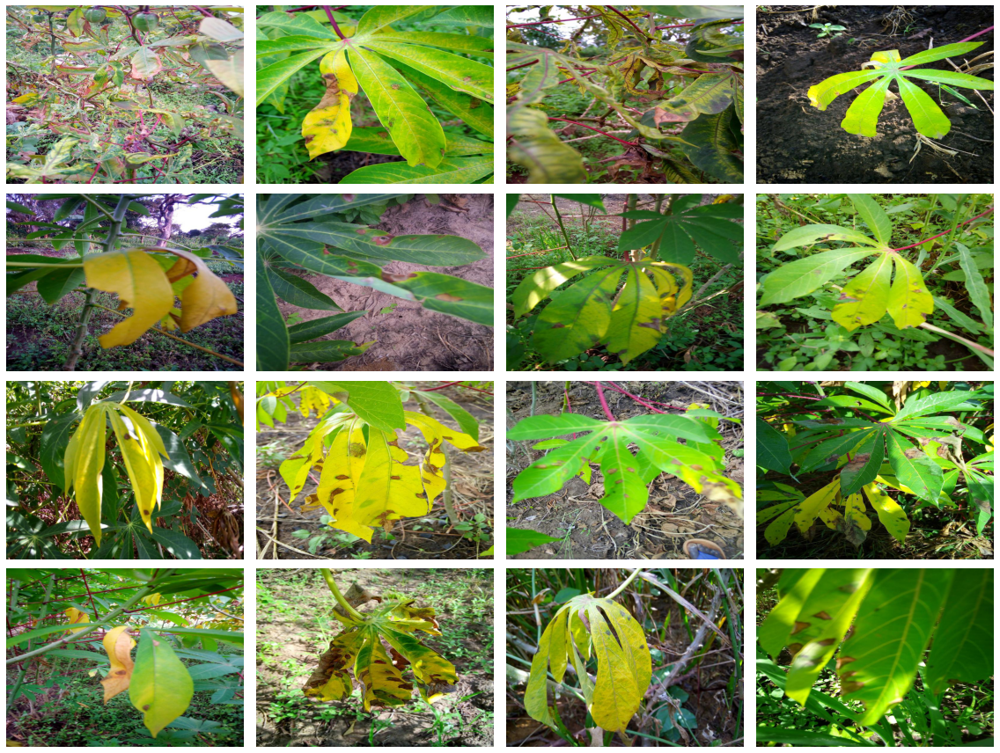

In [ ]:
mask = df_train['label'] ==0
CBB = df_train[mask]
showImages(CBB['image_id'])

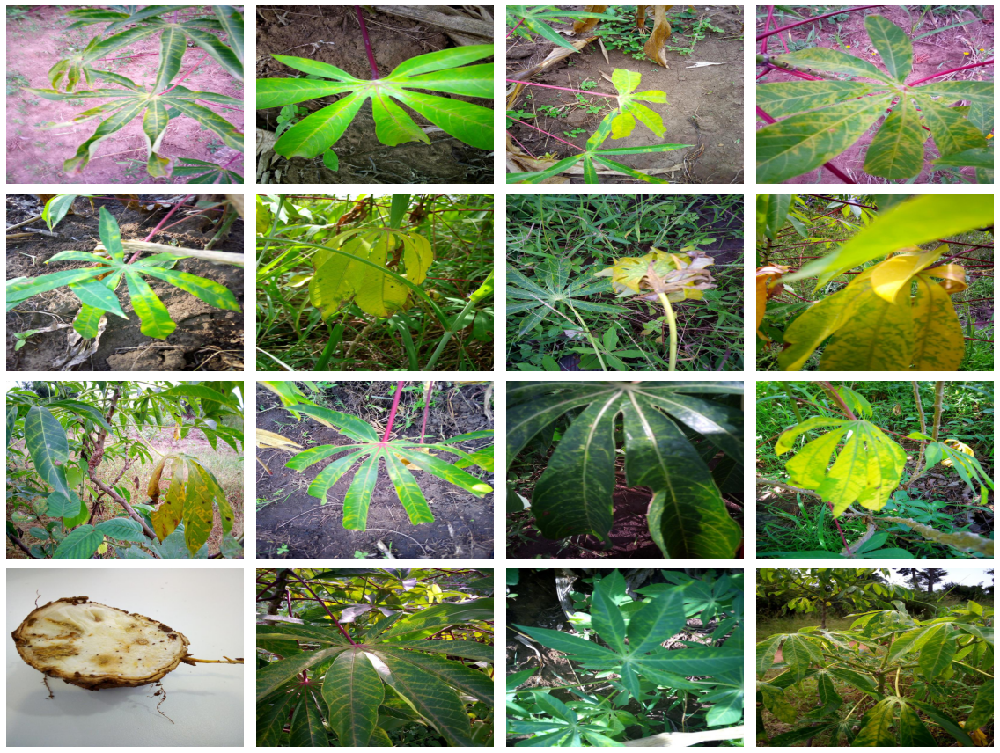

In [ ]:
mask = df_train['label'] ==1
CBSD = df_train[mask]
showImages(CBSD['image_id'])

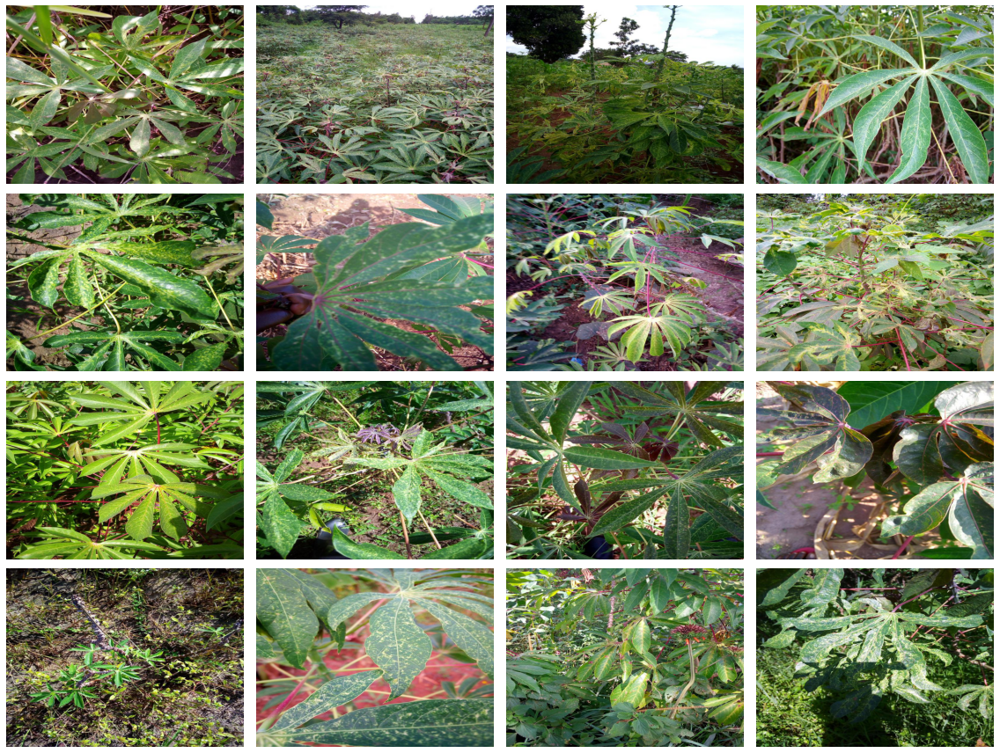

In [ ]:
mask = df_train['label'] ==2
CGM = df_train[mask]
showImages(CGM['image_id'])

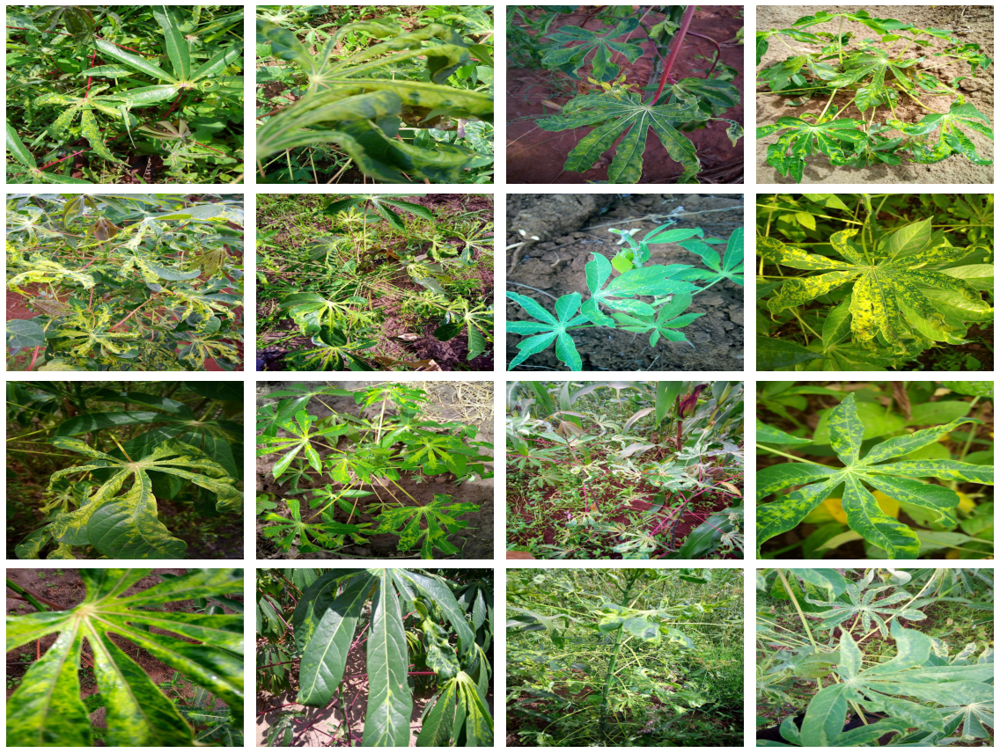

In [ ]:
mask = df_train['label'] ==3
CMD = df_train[mask]
showImages(CMD['image_id'])

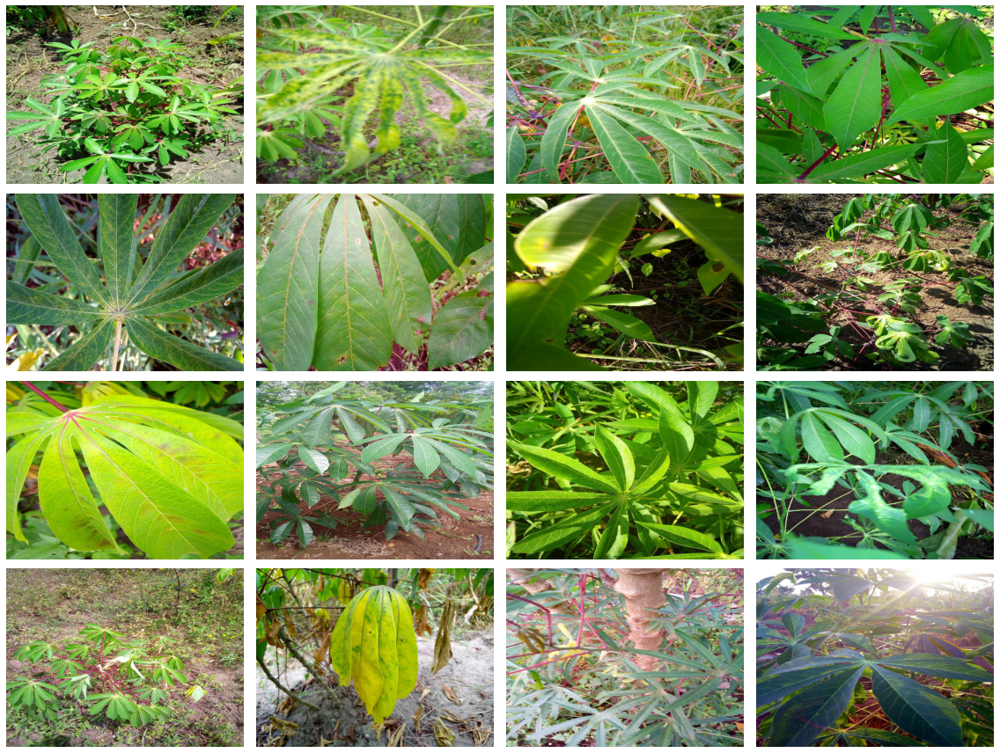

In [ ]:
mask = df_train['label'] ==4
Healthy = df_train[mask]
showImages(Healthy['image_id'])

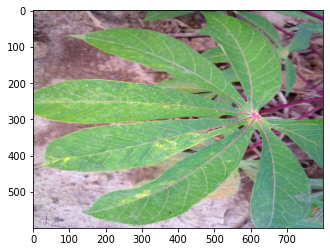

In [ ]:
img_tmp = df_train['image_id'][62]
img_rgb = get_image(img_tmp)
plt.imshow(img_rgb)

In [ ]:
print('Image Type: ',type(img_rgb))
print('Image Hight: ',img_rgb.shape[0])
print('Image Width: ',img_rgb.shape[1])
print('Image Dimension:', img_rgb.ndim)
print('Image size:', img_rgb.size)
print()
print("RGB Information:")
print('The maximum RGB value in this image {}'.format(img_rgb.max()))
print('The minimum RGB value in this image {}'.format(img_rgb.min()))
print()
print('Value of only R channel {}'.format(img_rgb[ 100, 50, 0]))
print('Value of only G channel {}'.format(img_rgb[ 100, 50, 1]))
print('Value of only B channel {}'.format(img_rgb[ 100, 50, 2]))

Image Type:  <class 'numpy.ndarray'>
Image Hight:  600
Image Width:  800
Image Dimension: 3
Image size: 1440000

RGB Information:
The maximum RGB value in this image 255
The minimum RGB value in this image 0

Value of only R channel 139
Value of only G channel 116
Value of only B channel 132


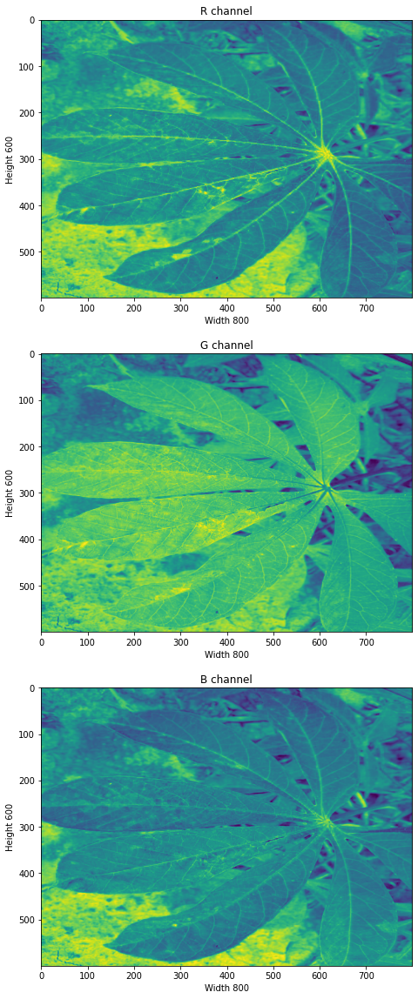

In [ ]:
fig, ax = plt.subplots(3,1, figsize=(20,20))

ax[0].set_title('R channel')
ax[0].set_ylabel('Height {}'.format(img_rgb.shape[0]))
ax[0].set_xlabel('Width {}'.format(img_rgb.shape[1]))
ax[0].imshow(img_rgb[ : , : , 0])
# print(img_rgb[ : , : , 0])

ax[1].set_title('G channel')
ax[1].set_ylabel('Height {}'.format(img_rgb.shape[0]))
ax[1].set_xlabel('Width {}'.format(img_rgb.shape[1]))
ax[1].imshow(img_rgb[ : , : , 1])

ax[2].set_title('B channel')
ax[2].set_ylabel('Height {}'.format(img_rgb.shape[0]))
ax[2].set_xlabel('Width {}'.format(img_rgb.shape[1]))
ax[2].imshow(img_rgb[ : , : , 2])
plt.show()

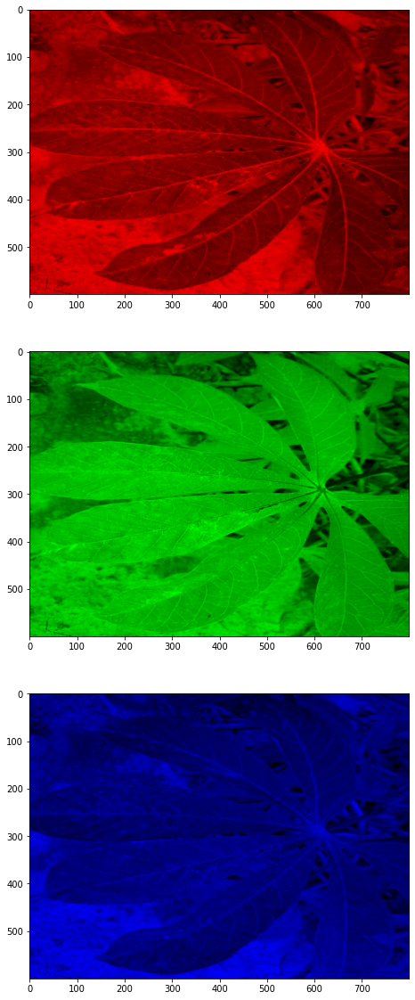

In [ ]:
fig, ax = plt.subplots(nrows = 3, ncols=1, figsize=(20,20))  
for i, ax in zip(range(3), ax):     
     split_img = np.zeros(img_rgb.shape, dtype="uint8")
     split_img[ :, :, i] = img_rgb[ :, :, i]
    #  print(split_img)
     ax.imshow(split_img)

3


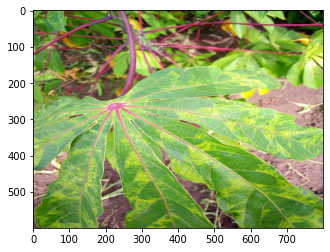

In [ ]:
img_tmp = df_train['image_id'][9]
img_3d = get_image(img_tmp)
plt.imshow(img_3d)
print(df_train['label'][9])

In [ ]:
from keras.preprocessing.image import img_to_array, load_img, ImageDataGenerator

In [ ]:
data_generator_rotation = ImageDataGenerator(rotation_range=30,fill_mode='nearest')

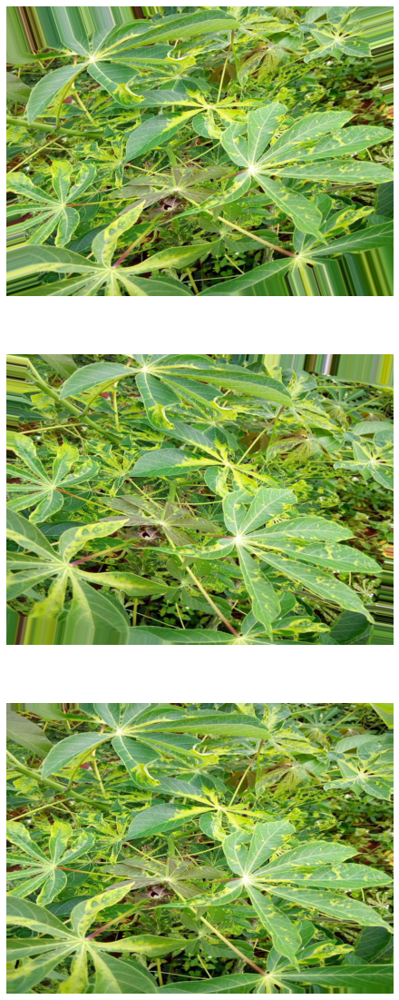

In [ ]:
#rotation
img_aug = df_train['image_id'][10]
img_aug = get_image(img_aug)
x = img_to_array(img_aug) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_rotation.flow(x, batch_size=1)

fig, ax = plt.subplots(3, 1, figsize=(20,20))

for i in range(3):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off') 

In [ ]:
data_generator_shift = ImageDataGenerator(width_shift_range=0.3,height_shift_range=0.3,fill_mode='nearest')

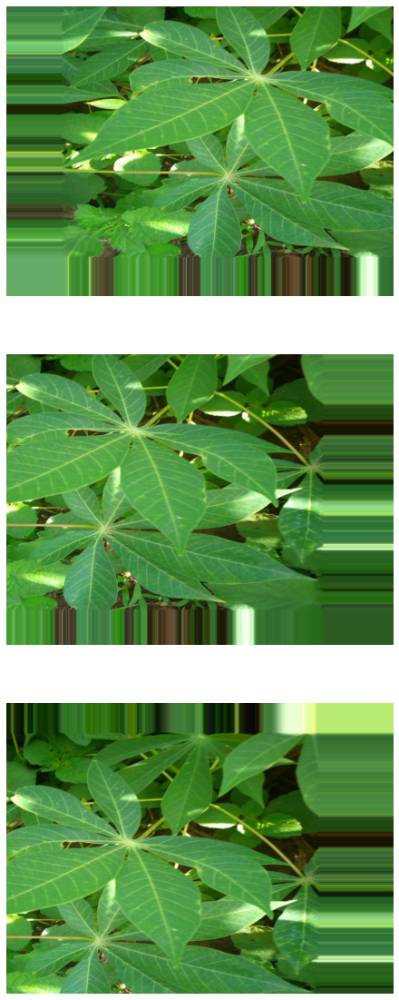

In [ ]:
#shifting
img_aug_1 = df_train['image_id'][2]
img_aug_1 = get_image(img_aug_1)
x = img_to_array(img_aug_1) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_shift.flow(x, batch_size=1)

fig, ax = plt.subplots(3, 1, figsize=(20,20))

for i in range(3):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

In [ ]:
data_generator_flip = ImageDataGenerator(horizontal_flip=True,vertical_flip=True,fill_mode='nearest')

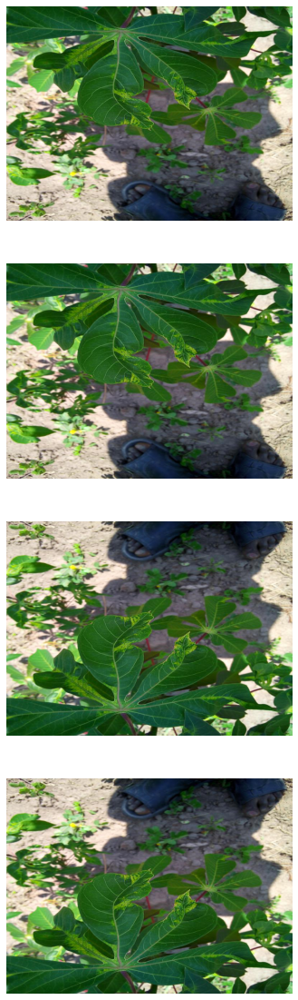

In [ ]:
#flip
img_aug_2 = df_train['image_id'][4]
img_aug_2 = get_image(img_aug_2)
x = img_to_array(img_aug_2) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_flip.flow(x, batch_size=1)

fig, ax = plt.subplots(4, 1, figsize=(20,20))

for i in range(4):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off') 

In [ ]:
data_generator_bright = ImageDataGenerator(brightness_range=[0.2,2.0],fill_mode='nearest')

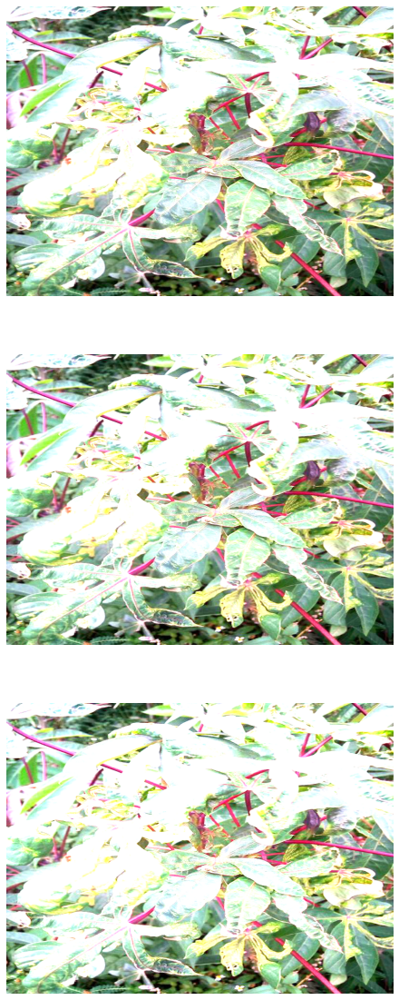

In [ ]:
#brightness
img_aug_2 = df_train['image_id'][5]
img_aug_2 = get_image(img_aug_2)
x = img_to_array(img_aug_2) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_bright.flow(x, batch_size=1)

fig, ax = plt.subplots(3, 1, figsize=(20,20))

for i in range(3):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

In [ ]:
data_generator_zoom = ImageDataGenerator(zoom_range=0.5)

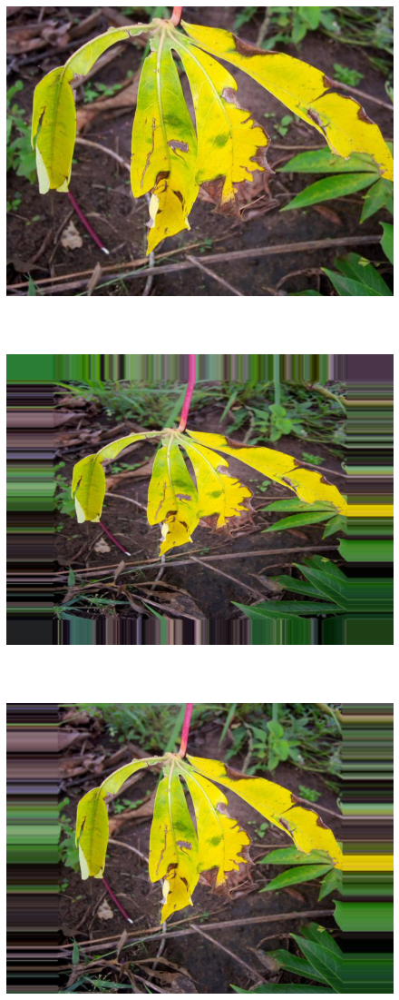

In [ ]:
#zoom
img_aug_2 = df_train['image_id'][8]
img_aug_2 = get_image(img_aug_2)
x = img_to_array(img_aug_2) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_zoom.flow(x, batch_size=1)

fig, ax = plt.subplots(3, 1, figsize=(20,20))

for i in range(3):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

In [ ]:
data_generator_shear = ImageDataGenerator(shear_range=40)

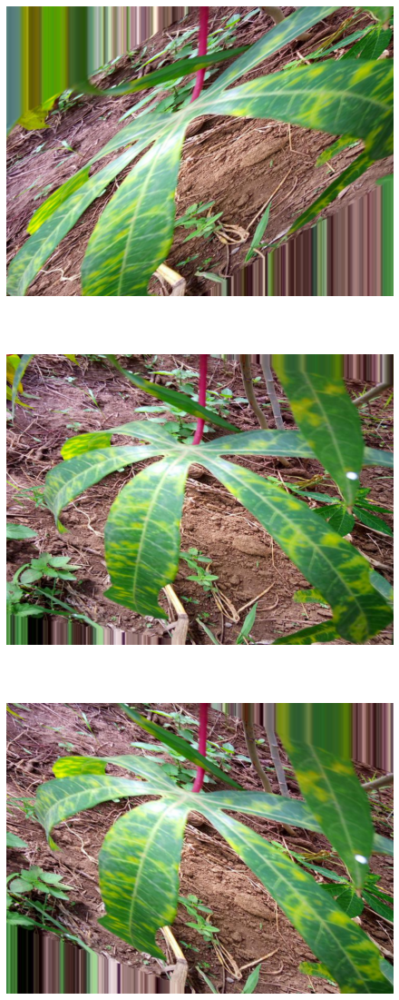

In [ ]:

img_aug_2 = df_train['image_id'][12]
img_aug_2 = get_image(img_aug_2)
x = img_to_array(img_aug_2) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator_shear.flow(x, batch_size=1)

fig, ax = plt.subplots(3, 1, figsize=(20,20))

for i in range(3):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

In [ ]:
data_generator = ImageDataGenerator(
    width_shift_range=0.3, 
    height_shift_range=0.3,
    horizontal_flip=True, 
    vertical_flip=True,
    brightness_range=[0.5,1.5],
    zoom_range=0.5,
    shear_range=20,
    fill_mode='nearest')

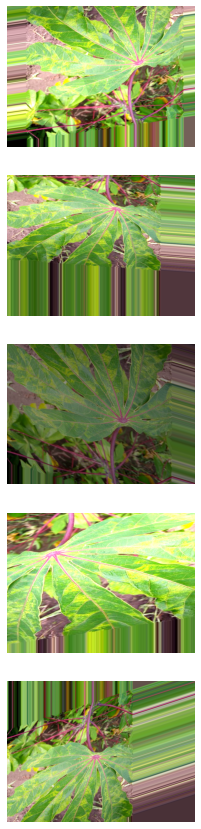

In [ ]:
img_aug_2 = df_train['image_id'][9]
img_aug_2 = get_image(img_aug_2)
x = img_to_array(img_aug_2) 
x = x.reshape((1,) + x.shape) 

# iterator
aug_iterator = data_generator.flow(x, batch_size=1)

fig, ax = plt.subplots(5,1, figsize=(15,15))

for i in range(5):
    image = next(aug_iterator)[0].astype('uint8')
    ax[i].imshow(image)
    ax[i].axis('off')  

In [ ]:
train_labels = pd.read_csv('/content/drive/MyDrive/cassava-leaf-disease-classification/cassava-leaf-disease-classification/train.csv')

In [ ]:
import glob
csv_df = pd.read_csv('/content/drive/MyDrive/cassava-leaf-disease-classification/cassava-leaf-disease-classification/train.csv')
train_dir = '/content/drive/MyDrive/cassava-leaf-disease-classification/cassava-leaf-disease-classification/train_tfrecords/*'
test_dir = '/content/drive/MyDrive/cassava-leaf-disease-classification/cassava-leaf-disease-classification/test_tfrecords/*'
train_list = glob.glob(train_dir)
test_list = glob.glob(test_dir)
print("train: " + str(len(train_list)) + "\ntest: " + str(len(test_list)))

train: 16
test: 1


In [ ]:
labels = train_labels
labels.head()

,image_id,label
0,1000015157.jpg,0
1,1000201771.jpg,3
2,100042118.jpg,1
3,1000723321.jpg,1
4,1000812911.jpg,3


In [ ]:
labels['label']=labels['label'].astype(str)

In [ ]:
train_datagen = ImageDataGenerator(rescale=1./225,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    validation_split=0.3,
    horizontal_flip=True,)


test_datagen = ImageDataGenerator(rescale=1./255)

In [ ]:
train_dir = '/content/drive/MyDrive/cassava-leaf-disease-classification/cassava-leaf-disease-classification/train_images/'

In [ ]:
train_generator = train_datagen.flow_from_dataframe(dataframe=labels,
      directory=train_dir,
      subset='training',
      x_col="image_id",
      y_col="label",
      shuffle=True,
      target_size=(150,150),
      batch_size=32,
      class_mode='categorical')

valid_generator = train_datagen.flow_from_dataframe(dataframe=labels,
      directory=train_dir,
      subset='validation',
      x_col="image_id",
      y_col="label",
      shuffle=True,
      target_size=(150,150),
      batch_size=32,
      class_mode='categorical')

Found 14978 validated image filenames belonging to 5 classes.
Found 6419 validated image filenames belonging to 5 classes.


In [ ]:
import keras
from keras.layers import Dense, Dropout, Input, MaxPooling2D, ZeroPadding2D, Conv2D, Flatten
from keras.models import Sequential, Model
from keras.losses import categorical_crossentropy
# from keras.optimizers import SGD
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers import SGD
from keras.preprocessing.image import img_to_array, load_img, ImageDataGenerator

from tensorflow.keras.utils import to_categorical
# from tensorflow.keras import regularizers

from tensorflow.keras.layers import MaxPool2D, AveragePooling2D, GlobalAveragePooling2D
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

# from zipfile import ZipFile
import time
from datetime import timedelta
from io import BytesIO

# Image manipulation.
import PIL.Image

import pickle
import os

import random

In [ ]:
def make_model_1():
    inputs = Input(shape = (150,150,3))
    model = Conv2D(filters=32, kernel_size=(3, 3),activation='softmax', input_shape=(150,150,3))(inputs)
    model = MaxPool2D(pool_size=(2, 2))(model)
    model = Conv2D(filters=64, kernel_size=(3, 3), activation='softmax')(model)
    model = MaxPool2D(pool_size=(2, 2))(model)
    model = Conv2D(filters=128, kernel_size=(3, 3), activation='softmax')(model)
    model = MaxPool2D(pool_size=(2, 2))(model)
    model = Flatten()(model)
    model = Dense(512, activation = "relu")(model)
    out = Dense(5, activation = 'softmax')(model)
    model = Model(inputs=inputs, outputs=out)
    
    model.compile(loss='categorical_crossentropy',
              optimizer=Adam(),
              metrics=['acc'])
    return model

In [ ]:
model = make_model_1()
print(model.summary())

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 74, 74, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 36, 36, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 128)       73856 

In [ ]:
history = model.fit(train_generator,steps_per_epoch=20,validation_data=valid_generator,validation_steps=20, epochs=5)

Epoch 1/5
20/20 [==============================] - 447s 23s/step - loss: 1.2499 - acc: 0.6500 - val_loss: 1.2123 - val_acc: 0.6297
Epoch 2/5
20/20 [==============================] - 419s 21s/step - loss: 1.2173 - acc: 0.6266 - val_loss: 1.1809 - val_acc: 0.6219
Epoch 3/5
20/20 [==============================] - 372s 19s/step - loss: 1.1475 - acc: 0.6438 - val_loss: 1.1919 - val_acc: 0.6156
Epoch 4/5
20/20 [==============================] - 348s 18s/step - loss: 1.2612 - acc: 0.5813 - val_loss: 1.2216 - val_acc: 0.5938
Epoch 5/5
20/20 [==============================] - 335s 17s/step - loss: 1.2307 - acc: 0.5953 - val_loss: 1.1903 - val_acc: 0.6141
